In [1]:
import os

# os.environ["XFORMERS_DISABLED"] = "1"
import sys
from pathlib import Path

SCRIPT_DIR = Path(os.getcwd())  # Sets SCRIPT_DIR to the notebook's directory
# print("SCRIPT_DIR:", SCRIPT_DIR)

# Add the neural_networks directory to sys.path for importing modules
sys.path.append(os.path.expanduser('~/projects/astroNNomy/src/astronnomy/training/'))
# print("Updated sys.path:", sys.path)
from astronnomy.training.train_nn import *
from source_dataloader import get_dataloaders_source
from torchvision.transforms.functional import hflip, gaussian_blur
torch.set_float32_matmul_precision('high')
import copy
import matplotlib.pyplot as plt
# import cv2
from sklearn.cluster import KMeans, Birch
from scipy.spatial.distance import cdist
from math import ceil
# os.environ["XFORMERS_DISABLED"] = "1"
import numpy as np
from metric_learn import LMNN

In [2]:
from cortexchange.wdclient import init_downloader
import os

# Make sure to store these variables.
login = os.getenv("WD_LOGIN")
password = os.getenv("WD_PASSWORD")


init_downloader(
    url="https://researchdrive.surfsara.nl/public.php/webdav/",
    cache=f"{os.path.join(os.path.expanduser('~'), '.cache/cortexchange')}",
    login=login,
    password=password,
)


from cortexchange.architecture import get_architecture, Architecture

Attempting authorization
Attempting authorization


In [3]:
TransferLearning: type(Architecture) = get_architecture("surf/TransferLearning")
model = TransferLearning(device="cuda", model_name="surf/dino_big_lora_default_pos_november_09876")
model.model.eval()

/home/larsve/projects/lofar_venv/lib/python3.12/site-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: '2.0.6' (you have '2.0.0'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
Using cache found in /home/larsve/.cache/torch/hub/facebookresearch_dinov2_main
/home/larsve/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/swiglu_ffn.py:43: UserWarning: xFormers is available (SwiGLU)
  warnings.warn("xFormers is available (SwiGLU)")
/home/larsve/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/attention.py:27: UserWarning: xFormers is available (Attention)
  warnings.warn("xFormers is available (Attention)")
/home/larsve/.cache/torch/hub/facebookresearch_dinov2_main/dinov2/layers/block.py:33: UserWarning: xFormers is available (Block)
  warnings.warn("xFormers is available (Block)")


768
Could not load optim due to 'ImagenetTransferLearning' object has no attribute 'classifier'; skipping.


In [4]:
train_loader, test_loader = get_dataloaders_source(
        "/scratch-shared/CORTEX/public.spider.surfsara.nl/lofarvwf/jdejong/CORTEX/calibrator_selection_robertjan/cnn_data/",
        64,
    )
mean, std = train_loader.dataset.compute_statistics(1)

________________________________________________________________________________
[Memory] Calling astronnomy.pre_processing_for_ml.FitsDataset._compute_statistics...
_compute_statistics(<source_dataloader.FitsAndSourceDataset object at 0x146ed477f5f0>, 1)
Computing dataset statistics
Finished Computing dataset statistics
___________________________________________compute_statistics - 1151.8s, 19.2min


/home/larsve/projects/lofar_venv/lib/python3.12/site-packages/joblib/memory.py:577: UserWarning: Persisting input arguments took 3.45s to run.If this happens often in your code, it can cause performance problems (results will be correct in all cases). The reason for this is probably some large input arguments for a wrapped function.
  return self._cached_call(args, kwargs, shelving=False)[0]


In [5]:
def cluster(model, loader, n_clusters=2, algos=[partial(KMeans, random_state=0), partial(Birch)]):
    # *_, h, w = model.prepare_batch(next(iter(loader))[0]).shape
    # patch_size = model.model.dino.encoder.patch_size
    # h0, w0 = h // patch_size, w//patch_size
    # patches = h0 * w0
    img_embeddings = []
    labels = []
    all_images = []
    sources = []
    for img, label, source_ids, step in loader:
        assert img.shape[0] == len(source_ids)
        labels.append(label)
        # n_images = len(img)
        with torch.no_grad():
            img = img#[label == 1]
            img = model.prepare_batch(img)
            x = model.model.lift(img)
            img_embedding = model.model.dino.encoder.forward(x)
            # features = features_dict["x_norm_patchtokens"].detach()#.cpu().to(torch.float32).numpy()
            # patch_features = features.reshape(n_images * patches, -1)
            img_embeddings.append(img_embedding)
            all_images.append(img.cpu().to(torch.float32).numpy())
            sources.append(source_ids)
    
    all_images = np.concatenate(all_images)
    labels = torch.cat(labels, dim=0).cpu().to(bool).numpy()
    img_embeddings = torch.cat(img_embeddings, dim=0).cpu().to(torch.float32).numpy()
    sources = torch.cat(sources, dim=0).cpu().numpy()
    unique_sources, counts = np.unique(sources, return_counts=True)
    valid_sources = unique_sources[counts >= 3]

    valid_mask = np.isin(sources, valid_sources)

    metrics = [LMNN(n_neighbors=3, random_state=0, verbose=False, min_iter=1, max_iter=1000).fit(img_embeddings[valid_mask], sources[valid_mask]), None]
    for algo in algos:
        algo = algo(n_clusters=n_clusters)
        for metric in metrics:
            if metric is not None:
                img_embeddings_transformed = metric.transform(img_embeddings)
            else:
                img_embeddings_transformed = img_embeddings

            preds = algo.fit_predict(img_embeddings_transformed)
            clusters = np.unique(preds)
            if len(clusters) == 1:
                print('only 1 cluster found')
                continue
        
            print(algo, metric)
            cluster_assignments = {k:[] for k in clusters}
            for im, pred in zip(all_images, preds):
                cluster_assignments[pred].append(im)
                # plt.imshow(np.transpose(im, (1, 2, 0)))
                # plt.show()
            
            for cluster, imgs in cluster_assignments.items():
                print(f'cluster {cluster}')
                max_images_per_row = 12
                nrows = ceil(len(imgs) / max_images_per_row)
                ncols=min(max_images_per_row, len(imgs))
                fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 2, nrows * 2))
                axes = np.array(axes).reshape(nrows, ncols)  # Ensure axes is always a 2D numpy array
                for j, im in enumerate(imgs):
                    row, col = divmod(j, ncols)
                    axes[row, col].imshow(np.transpose(im, (1, 2, 0)))
                    axes[row, col].axis('off')

                plt.tight_layout()
                plt.show()

/home/larsve/projects/lofar_venv/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/larsve/projects/lofar_venv/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/larsve/projects/lofar_venv/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/larsve/projects/lofar_venv/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Birch(n_clusters=6) LMNN(min_iter=1, random_state=0)
cluster 0


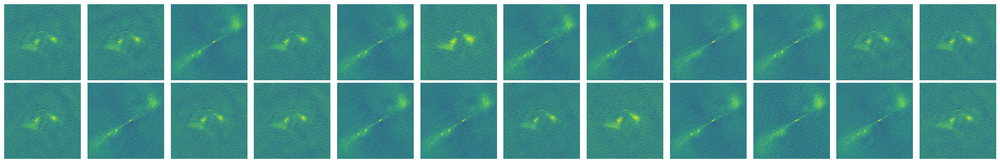

cluster 1


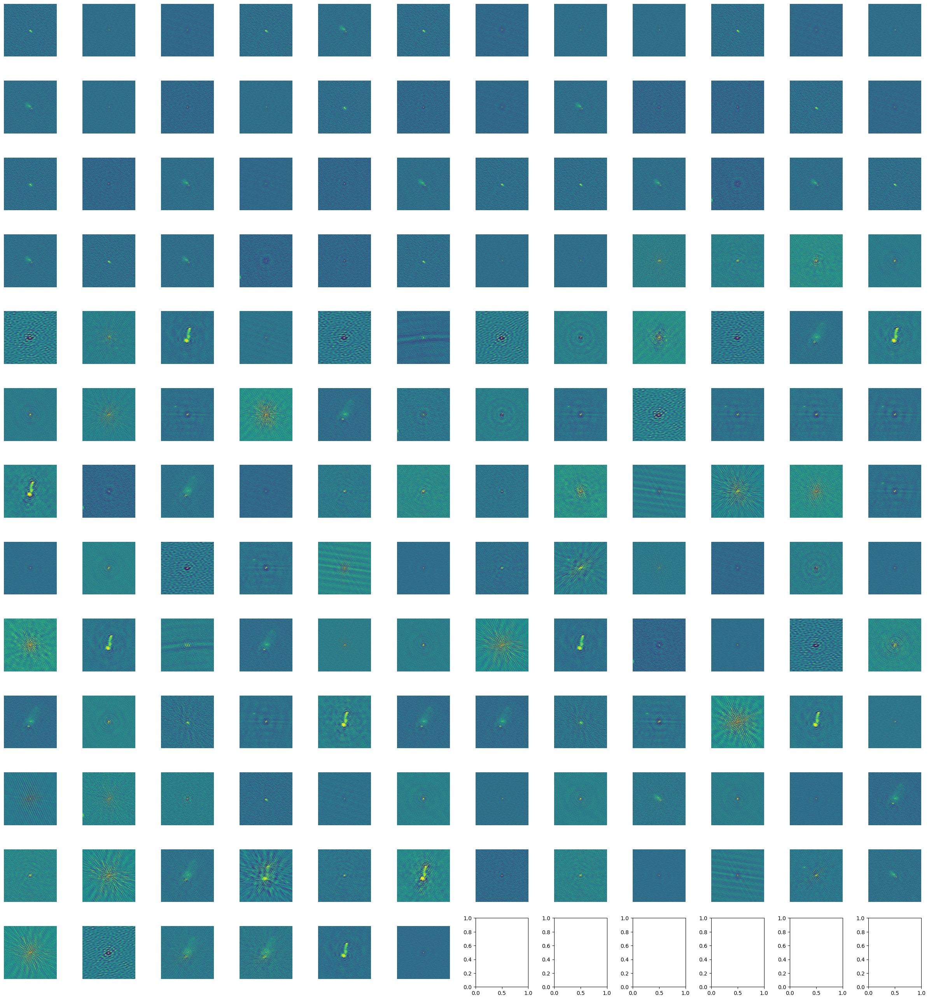

cluster 2


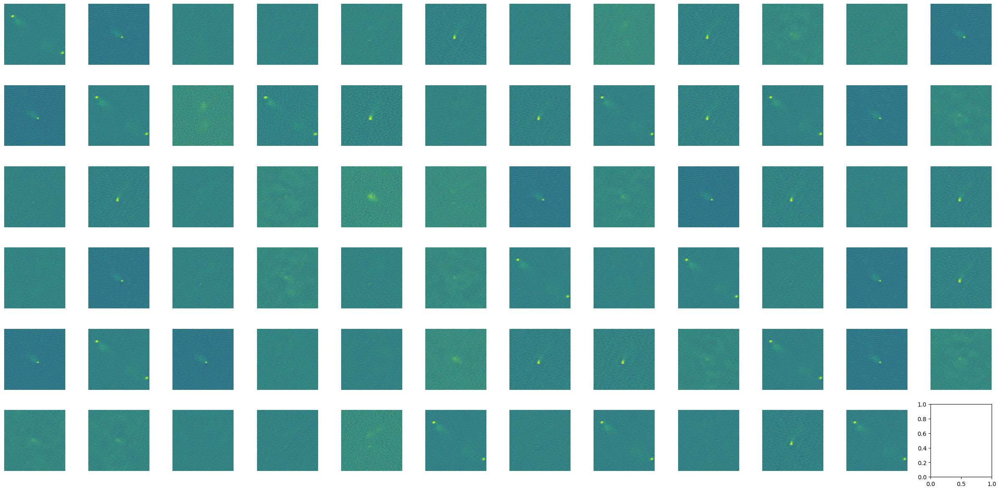

cluster 3


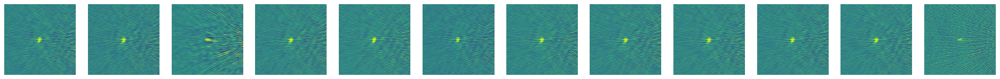

cluster 4


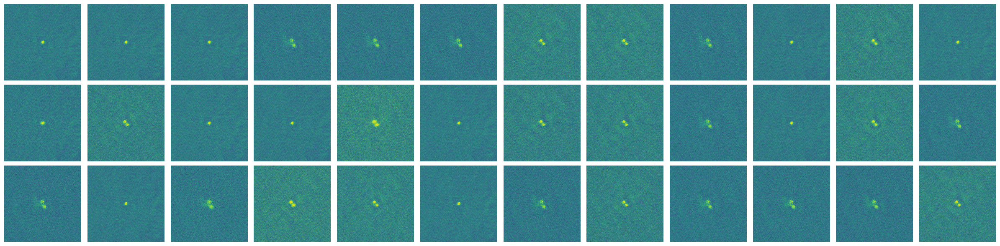

cluster 5


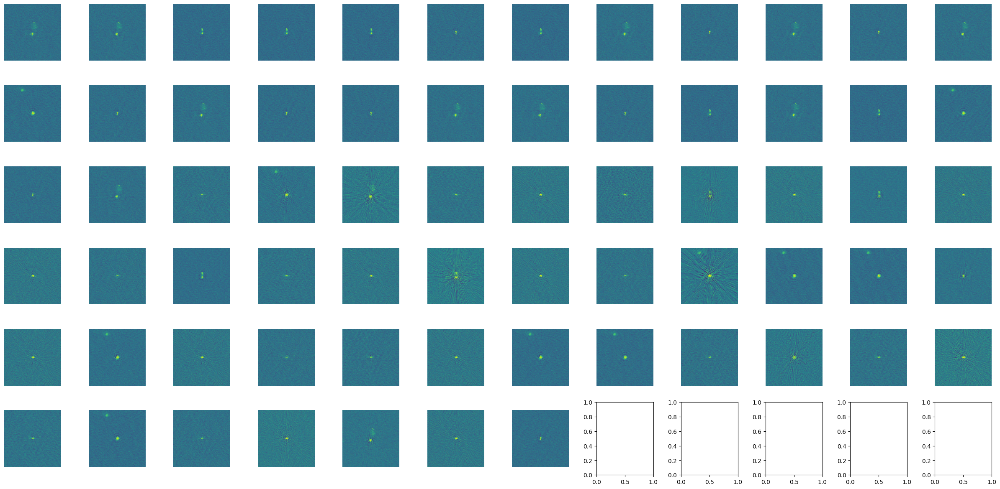

Birch(n_clusters=6) None
cluster 0


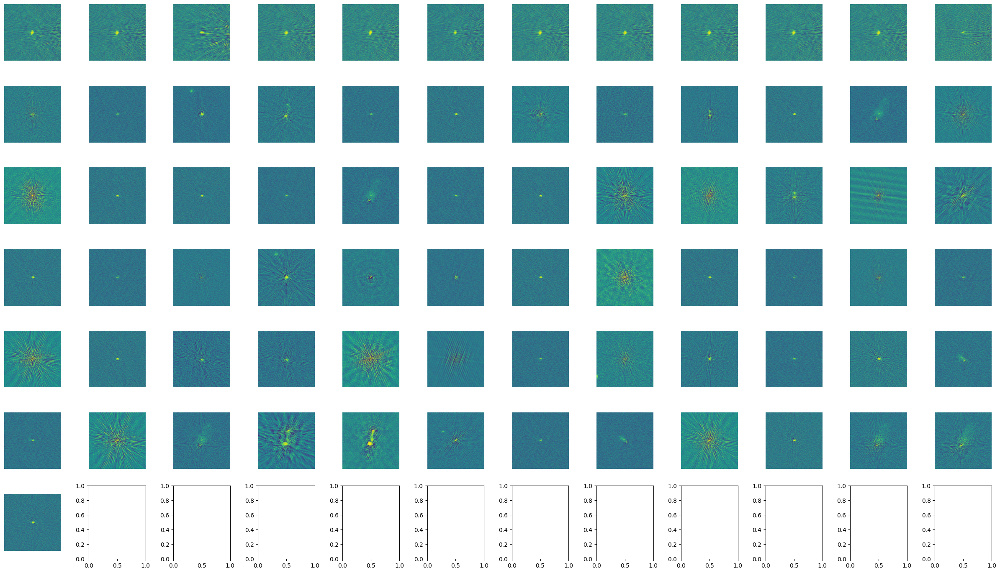

cluster 1


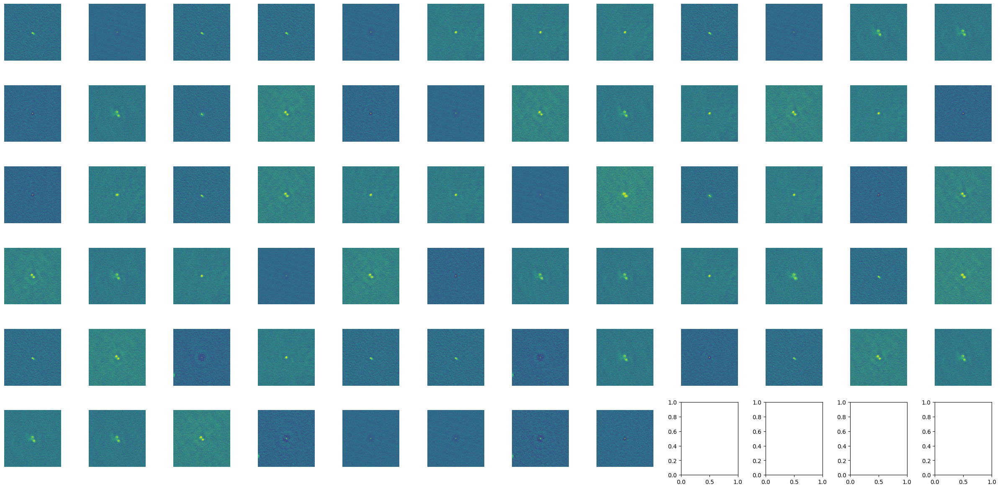

cluster 2


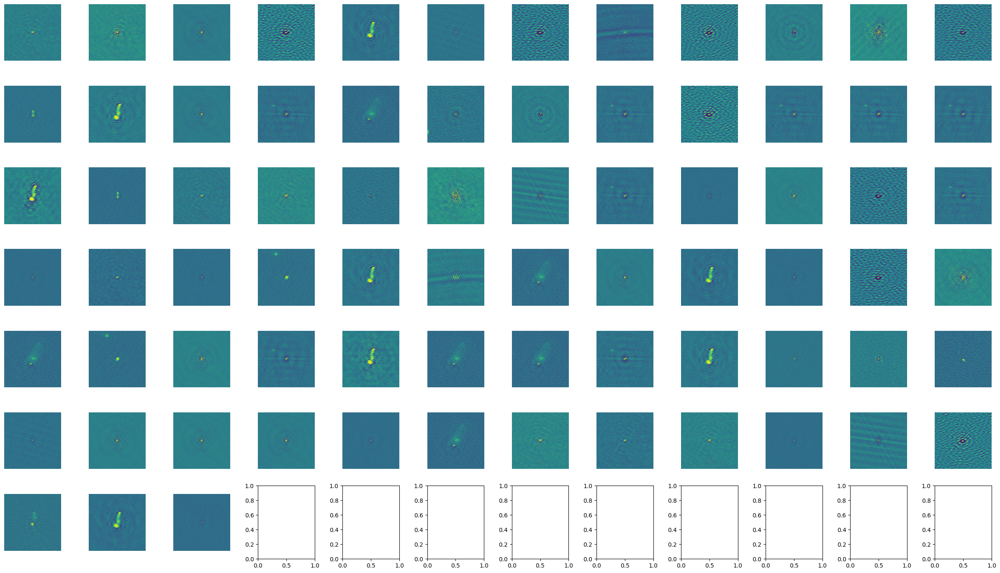

cluster 3


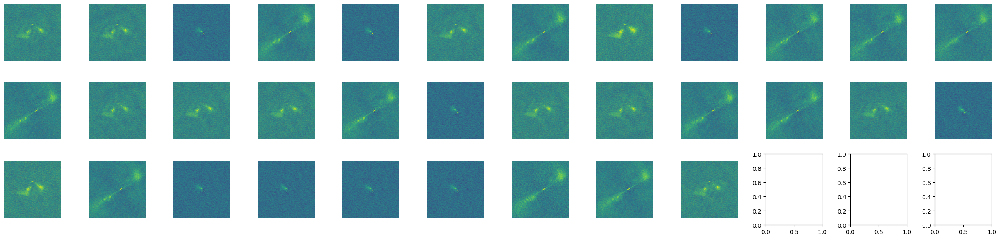

cluster 4


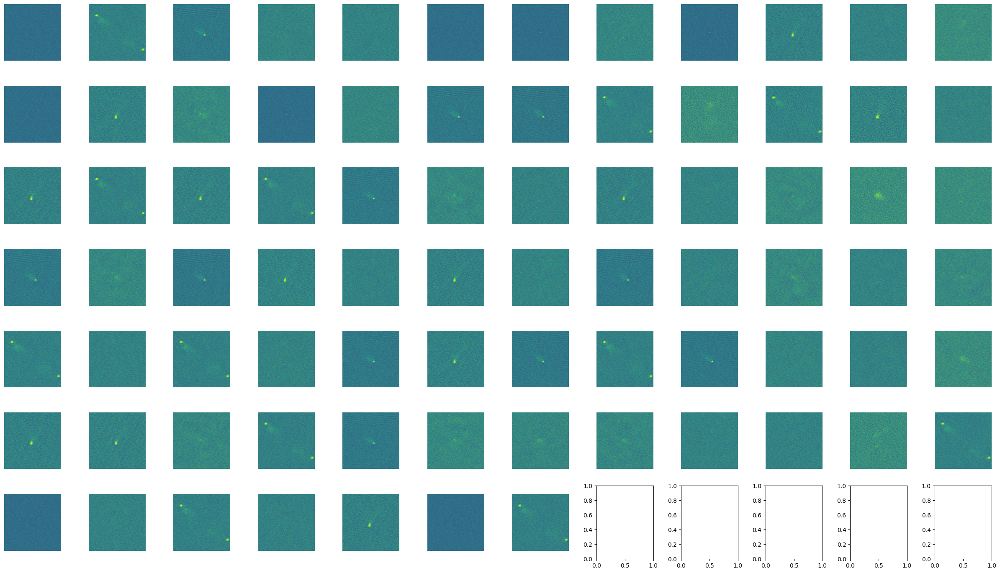

cluster 5


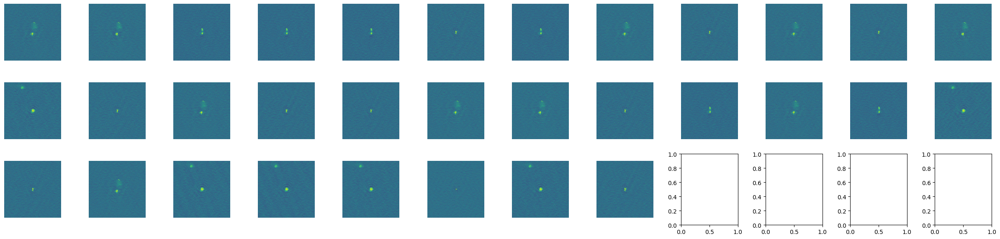

In [6]:
cluster(model, test_loader, n_clusters=6, algos=[partial(Birch)])